In [ ]:
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install ydata_profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 24.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 52.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=c258a0f1f26bc717a40019dcdd03772a34a49aa3226b83479f900872c36c3a93
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport
#Import all relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import plotly.express as px

## This statement allows the visuals to render within your Jupyter Notebook.
%matplotlib inline

#Jarir

In [71]:
jdf=pd.read_csv('/content/drive/MyDrive/Unsuervised-project/teamwork/Data/Jarir_laptops.csv')
profile=ProfileReport(jdf,title='laptops')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [72]:
import re

In [73]:
jdf=jdf[jdf['RAM'].notna()]

In [74]:
jdf['RAM Size'] = jdf['RAM'].apply(lambda x: int(re.search(r'\d+', x).group()))

<ipython-input-74-37b246b9fb95>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  jdf['RAM Size'] = jdf['RAM'].apply(lambda x: int(re.search(r'\d+', x).group()))


In [75]:
jdf['RAM Size'] =jdf['RAM Size'].astype(int)

<ipython-input-75-f59572892ef3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  jdf['RAM Size'] =jdf['RAM Size'].astype(int)


In [76]:
jdf=jdf[jdf['RAM Size']>=18]

In [77]:
jdf=jdf.loc[:,['Product Title','Product Price','processor type','display type','graphics card','display size','operating system','processor speed','capacity','display resolution','battery type','RAM Size']]

In [78]:
profile=ProfileReport(jdf,title='laptops')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [79]:
jdf.columns

Index(['Product Title', 'Product Price', 'processor type', 'display type',
       'graphics card', 'display size', 'operating system', 'processor speed',
       'capacity', 'display resolution', 'battery type', 'RAM Size'],
      dtype='object')

In [87]:
# Reverse mapping dictionary to rename columns back to original names
reverse_column_names = {
    'Product Price': 'Product Price',
    'Product Title': 'Model Number',
    'processor type': 'Processor Type',
    'processor speed': 'Processor Speed',
    'RAM Size': 'RAM Size',
    'capacity': 'Storage Capacity',
    'graphics card': 'Graphics Card',
    'display size': 'Screen Size',
    'display resolution': 'Display Resolution',
    'operating system': 'Operating System',
    'battery type': 'Battery Type',
    'display type': 'Display Type'
}

In [88]:
jdf.rename(columns=reverse_column_names, inplace=True)

#GOlden

In [82]:
df = pd.read_csv("/content/drive/MyDrive/Unsuervised-project/teamwork/Data/GoldenTechnology.xls")

In [84]:
df['RAM Size'] = df['RAM Size'].str.replace('GB', '').astype(int)

In [83]:
# Function to extract size and type
def extract_ram_info(ram):
    size_match = re.search(r'(\d+GB|\d+MB)', ram)
    type_match = re.search(r'(DDR\d+|LPDDR\d+|SO-DIMM|Soldered|Ram)', ram)

    size = size_match.group(0) if size_match else None
    ram_type = type_match.group(0) if type_match else None

    return pd.Series([size, ram_type])

# Apply the function to split RAM into size and type
df[['RAM Size', 'RAM Type']] = df['RAM'].apply(extract_ram_info)

In [ ]:
df=df.loc[:,['Product Price','Model Number','Processor Type','Processor Speed','RAM Size','Storage Capacity','Graphics Card','Screen Size','Display Resolution','Operating System','Battery Type','Display Type']]

In [89]:
cdf= pd.concat([df, jdf], axis=0, ignore_index=True)

#Combined dataframes

In [97]:
profile=ProfileReport(ccdf,title='laptops')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##Uniqueness

In [136]:
cdf.duplicated().sum()

31

In [169]:
ccdf=cdf.drop_duplicates()

##Completeness

In [163]:
ccdf.isnull().sum()

,0
Product Price,0
Model Number,0
Processor Type,0
Processor Speed,26
RAM Size,0
Storage Capacity,0
Graphics Card,0
Screen Size,0
Display Resolution,0
Operating System,0


In [170]:
# Dictionary to map processor types to their base speeds (in GHz)
processor_speed_map = {
    "Intel Core i3-N300": "3.0 GHz",
    "Intel Core i7-13700H (13th Gen)": "2.4 GHz",
    "Intel Core Ultra 7-150U": "3.0 GHz",
    "Intel Core Ultra 5-125U": "2.8 GHz",
    "AMD Ryzen 7-5800H": "3.2 GHz",
    "Microsoft SQ 3 Neural Processing Unit (NPU)": "3.0 GHz",
    "Intel Core Ultra 7-155H": "3.5 GHz",

    "M4 Pro 14-core CPU": "3.5 GHz",  # Assuming M4 Pro runs at around 3.5 GHz
    "M4 Max 14-core CPU": "3.7 GHz",  # Assuming M4 Max runs at around 3.7 GHz
    "M4 Max 16-core CPU": "3.8 GHz",  # Assuming M4 Max with more cores might have slightly higher base clock
    "M4 10-core CPU": "3.2 GHz",      # Assuming M4 10-core runs at around 3.2 GHz
    "M3 8-core CPU": "3.1 GHz",       # Assuming M3 8-core runs at around 3.1 GHz
    "M3 Pro 12-core CPU": "3.3 GHz",  # Assuming M3 Pro 12-core runs at around 3.3 GHz
    "M3 Max 14-core CPU": "3.5 GHz",  # Assuming M3 Max 14-core runs at around 3.5 GHz
    "M3 8-core CPU": "3.0 GHz",       # Assuming M3 8-core runs at around 3.0 GHz
    "M3 Pro 11-core CPU": "3.2 GHz",  # Assuming M3 Pro 11-core runs at around 3.2 GHz
    "M3 Pro 12-core CPU": "3.3 GHz",  # Assuming M3 Pro 12-core runs at around 3.3 GHz
    "M3 Max 16-core CPU": "3.6 GHz",  # Assuming M3 Max 16-core runs at around 3.6 GHz
    "M4 Pro 12-core CPU": "3.5 GHz",
}


# Fill missing values in Processor Speed where it's null based on Processor Type
ccdf['Processor Speed'] = ccdf.apply(
    lambda row: processor_speed_map.get(row['Processor Type'], row['Processor Speed']) if pd.isnull(row['Processor Speed']) else row['Processor Speed'],
    axis=1
)


<ipython-input-170-f869878ec2d7>:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Processor Speed'] = ccdf.apply(


In [171]:
print(ccdf['Processor Speed'].unique())

['1.2 GHz' '2.4 GHz' '8-Core CPU' '2.8 GHz' '1.7 GHz' '3.0 GHz' '1.6 GHz'
 '1.3 GHz' '14-core CPU' '3.5 GHz' '3.1 GHz' '12-core CPU' '1.5 GHz'
 '0.9 GHz' '1.9 GHz' '3.3 GHz' '2.2 GHz' '1.8 GHz' '2.5 GHz' '4.0 GHz'
 '2.3 GHz' '1.1 GHz' '2.6 GHz' '2.0 GHz' '3.2 GHz' '2.7 GHz' '2.1 GHz'
 '3.4 GHz' '16-core CPU' '3.7 GHz' '3.8 GHz' '1.4 GHz' '11-core CPU'
 '3.6 GHz' 'P-core: 2.3 - 5.1 GHz/E-core: 1.8 - 3.8 GHz' '1.4 - 4.8 GHz'
 'up to 4.8 GHz' '4.8 GHz']


In [172]:
ccdf['Display Type'].describe()

,Display Type
count,280
unique,24
top,Full HD
freq,159


In [173]:
ccdf['Display Type']=ccdf['Display Type'].fillna('Full HD')

<ipython-input-173-ce7b8c21c347>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Display Type']=ccdf['Display Type'].fillna('Full HD')


In [174]:
profile=ProfileReport(ccdf,title='laptops')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Accuracy check

In [177]:
ccdf.dtypes

,0
Product Price,float64
Model Number,object
Processor Type,object
Processor Speed,object
RAM Size,int64
Storage Capacity,object
Graphics Card,object
Screen Size,object
Display Resolution,object
Operating System,object


In [176]:
# Remove " SR" and commas, then convert to float
ccdf['Product Price'] = ccdf['Product Price']\
    .str.replace(' SR', '', regex=False) \
    .str.replace(',', '', regex=False) \
    .astype(float)

<ipython-input-176-2c4942894514>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Product Price'] = ccdf['Product Price']\


In [178]:
ccdf['Processor Speed'] = ccdf.apply(
    lambda row: '3.2 GHz' if row['Processor Type'] in ['Apple M1 chip', 'Apple M2 chip'] and row['Processor Speed'] == '8-Core CPU' else
                ('3.4 GHz' if row['Processor Type'] == 'Apple M3 chip' and row['Processor Speed'] == '8-Core CPU' else row['Processor Speed']),
    axis=1
)

ccdf['Processor Speed'] = ccdf['Processor Speed'].replace('14-core CPU', '3.4 GHz')
ccdf['Processor Speed'] = ccdf['Processor Speed'].replace('12-core CPU', '3.5 GHz')
ccdf['Processor Speed'] = ccdf['Processor Speed'].replace('16-core CPU', '3.6 GHz')
ccdf['Processor Speed'] = ccdf['Processor Speed'].replace('11-core CPU', '3.3 GHz')

<ipython-input-178-def21dac1691>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Processor Speed'] = ccdf.apply(
<ipython-input-178-def21dac1691>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Processor Speed'] = ccdf['Processor Speed'].replace('14-core CPU', '3.4 GHz')
<ipython-input-178-def21dac1691>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: htt

In [196]:
def extract_max_ghz(speed):
    if isinstance(speed, str):
        # Match all GHz values in the string
        matches = re.findall(r'(\d+(\.\d+)?)\s*GHz', speed)
        if matches:
            # Convert matches to float and return the maximum
            return max(float(match[0]) for match in matches)
        # Handle "up to" descriptions
        elif 'up to' in speed:
            return float(speed.split(' ')[-2])  # Get the value before "GHz"
        # Handle ranges, e.g., "1.4 - 4.8 GHz"
        elif '-' in speed:
            parts = speed.split('-')
            return max(float(part.strip().replace(' GHz', '')) for part in parts)
    return speed


# Apply the extraction to the DataFrame column
ccdf['Processor Speed'] = ccdf['Processor Speed'].apply(extract_max_ghz)

<ipython-input-196-1e5e96476be9>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Processor Speed'] = ccdf['Processor Speed'].apply(extract_max_ghz)


In [199]:
print(ccdf['Storage Capacity'].unique())

['512GB SSD M.2' '256GB SSD M.2' '256GB SSD' '1TB SSD M.2' '512GB SSD'
 '2TB SSD M.2 + SSD M.2' '1TB SSD' '2TB SSD M.2'
 '256GB SSD M.2 + 16GB Intel Optane Memory'
 '512GB SSD M.2 + 32GB Intel Optane Memory' '1TB HDD'
 '1TB SSD M.2 2280 PCIe 4.0x4 NVMe' '128GB eMMC' '2TB SSD' '128GB SSD'
 '1TB HDD + 256GB SSD M.2' '64GB eMMC' '1 TB SSD'
 '1 TB M.2 NVMe PCIe 4.0 SSD' '512 GB SSD' '2 TB PCIe NVMe M.2 SSD'
 '1 TB NVMe PCIe Gen 4×4 SSD' '1 TB PCIe NVMe M.2 SSD' '1 TB'
 '2 TB M.2 PCIe NVMe 4.0 SSD']


In [198]:
ccdf['Storage Capacity'] = ccdf['Storage Capacity'].replace('2x 1TB SSD M.2', '2TB SSD M.2 + SSD M.2')

<ipython-input-198-7f728706d712>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Storage Capacity'] = ccdf['Storage Capacity'].replace('2x 1TB SSD M.2', '2TB SSD M.2 + SSD M.2')


In [200]:
# Use str.extract to split into Size and Type columns
ccdf[['Storage Value', 'Storage Type']] = ccdf['Storage Capacity'].str.extract(r'(\d+\s?[A-Za-z]+)\s*(.*)')

<ipython-input-200-426a29745624>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf[['Storage Value', 'Storage Type']] = ccdf['Storage Capacity'].str.extract(r'(\d+\s?[A-Za-z]+)\s*(.*)')
<ipython-input-200-426a29745624>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf[['Storage Value', 'Storage Type']] = ccdf['Storage Capacity'].str.extract(r'(\d+\s?[A-Za-z]+)\s*(.*)')


In [203]:
# Function to convert TB to GB
def convert_tb_to_gb(value):
    if 'TB' in value:
        # Extract the number part before 'TB', convert to float, and multiply by 1024 to convert to GB
        number = float(value.split(' ')[0].replace('TB', '').strip())
        return f"{number * 1024}GB"
    return value

# Apply the function to the 'Storage Value' column
ccdf['Storage Value'] = ccdf['Storage Value'].apply(convert_tb_to_gb)

<ipython-input-203-682cd07e7219>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Storage Value'] = ccdf['Storage Value'].apply(convert_tb_to_gb)


In [206]:
ccdf['Storage Value'] = ccdf['Storage Value'].str.replace('GB', '').astype(float)

<ipython-input-206-964264ceb145>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Storage Value'] = ccdf['Storage Value'].str.replace('GB', '').astype(float)


In [207]:
print(ccdf['Storage Value'].unique())

[ 512.  256. 1024. 2048.  128.   64.]


In [208]:
ccdf['Storage Value']=ccdf['Storage Value'].astype(int)

<ipython-input-208-011b5a66ce04>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Storage Value']=ccdf['Storage Value'].astype(int)


In [210]:
ccdf['Screen Size'] = ccdf['Screen Size'].str.replace(r'[^\d.]', '', regex=True).astype(float)

<ipython-input-210-023c8abee945>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Screen Size'] = ccdf['Screen Size'].str.replace(r'[^\d.]', '', regex=True).astype(float)


In [211]:
ccdf.dtypes

,0
Product Price,float64
Model Number,object
Processor Type,object
Processor Speed,float64
RAM Size,int64
Storage Capacity,object
Graphics Card,object
Screen Size,float64
Display Resolution,object
Operating System,object


In [212]:

# Function to clean and split display resolutions
def extract_dimensions(resolution):
    # Remove extra spaces and standardize the format
    resolution = resolution.replace(' ', '')  # Remove all spaces
    resolution = resolution.replace('×', 'x')  # Replace multiplication sign with 'x'

    # Use regex to extract width and height
    match = re.search(r'(\d+)[xX](\d+)', resolution)
    if match:
        width = match.group(1)
        height = match.group(2)
        return pd.Series([width, height])
    else:
        return pd.Series([None, None])  # Return None if no match found

# Apply the function to extract width and height
ccdf[['Width', 'Height']] = ccdf['Display Resolution'].apply(extract_dimensions)

<ipython-input-212-3e874f3a30a2>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf[['Width', 'Height']] = ccdf['Display Resolution'].apply(extract_dimensions)
<ipython-input-212-3e874f3a30a2>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf[['Width', 'Height']] = ccdf['Display Resolution'].apply(extract_dimensions)


In [ ]:
# dff_cleaned=dff_cleaned['Model Number','Product Type','Processor Type','Processor Speed','Graphics Card','Screen Size','Operating System','Battery Type','Brand','Display Type','RAM Size','RAM Type','Storage Value','Storage Type','Width','Height']

In [55]:
unique_values = df_cleaned['Display Resolution'].unique()

print(unique_values)

['2880X1920 (267 PPI)' '1920x1080' 'Liquid Retina 2880x1864'
 '2560 x1600 QHD' 'WUXGA+ 1920x1280, IPS' '3024x1964'
 '1920 x 1080 FHD IPS' '1920x1200' '2560x1600 WQXGA' '4480x2520'
 '2400×1600' '3456x2234' 'Liquid Retina 2560x1664' '3200x2000'
 '3840X2160 4k OLED' '1920x1200 Full HD' 'WUXGA 1920x1200 IPS'
 '1366 x 768 HD' '3840 x 2400 WQUXGA' '2880x1620' '2560 x1440 QHD'
 '2256 x 1504 PPI' '2560x1080' '3072x1920' '3K (3072x1440)'
 '2880x1800 OLED 400nits Glossy IPS' '2880x1920'
 'Retina Display 2560x1600' '1920 x 1280 (220 PPI)']


In [213]:

# Function to clean and split display resolutions
def extract_dimensions(resolution):
    # Remove extra spaces and standardize the format
    resolution = resolution.replace(' ', '')  # Remove all spaces
    resolution = resolution.replace('×', 'x')  # Replace multiplication sign with 'x'

    # Use regex to extract width and height
    match = re.search(r'(\d+)[xX](\d+)', resolution)
    if match:
        width = match.group(1)
        height = match.group(2)
        return pd.Series([width, height])
    else:
        return pd.Series([None, None])  # Return None if no match found

# Apply the function to extract width and height
ccdf[['Width', 'Height']] = ccdf['Display Resolution'].apply(extract_dimensions)


<ipython-input-213-3e874f3a30a2>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf[['Width', 'Height']] = ccdf['Display Resolution'].apply(extract_dimensions)


In [214]:
ccdf['Width']=ccdf['Width'].astype(int)
ccdf['Height']=ccdf['Height'].astype(int)

<ipython-input-214-6a0be45abcda>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Width']=ccdf['Width'].astype(int)
<ipython-input-214-6a0be45abcda>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ccdf['Height']=ccdf['Height'].astype(int)


In [215]:
ccdf.dtypes

,0
Product Price,float64
Model Number,object
Processor Type,object
Processor Speed,float64
RAM Size,int64
Storage Capacity,object
Graphics Card,object
Screen Size,float64
Display Resolution,object
Operating System,object


In [251]:
ccdf=ccdf[ccdf['RAM Size']<64]

In [402]:
ccdf=ccdf[ccdf['Processor Speed']<4.8]

In [409]:
value_counts = ccdf['Storage Value'].value_counts()

# Filter values that appear 5 or more times
values_to_keep = value_counts[value_counts >=5].index

# Filter the DataFrame
ccdf=ccdf[ccdf['Storage Value'].isin(values_to_keep)]

In [410]:
profile=ProfileReport(ccdf,title='laptops')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#Feature selection

In [217]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn import metrics

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
import warnings
warnings.filterwarnings("ignore")

In [517]:
ccdf.columns

Index(['Product Price', 'Model Number', 'Processor Type', 'Processor Speed',
       'RAM Size', 'Storage Capacity', 'Graphics Card', 'Screen Size',
       'Display Resolution', 'Operating System', 'Battery Type',
       'Display Type', 'Max_GHz', 'Storage Value', 'Storage Type', 'Width',
       'Height', 'Processor_Type_encoded', 'Graphics_Card_encoded',
       'Operating_System_encoded', 'Storage_Type_encoded',
       'Operating System_encoded', 'Display_Type_encoded',
       'Battery_Type_encoded'],
      dtype='object')

In [960]:
# Define the mapping of Storage Types to their performance ranking
storage_type_ranking = {
    'HDD': 0,
    'HDD + 256GB SSD M.2': 1,
    'SSD': 2,
    'SSD M.2': 3,
    'SSD M.2 + 16GB Intel Optane Memory': 4,
    'SSD M.2 + 32GB Intel Optane Memory': 5,
    'M.2 NVMe PCIe 4.0 SSD': 6,
    'NVMe PCIe Gen 4×4 SSD': 7,
    'SSD M.2 2280 PCIe 4.0x4 NVMe': 8
}

# Create a new column to map the storage type to its ranking
ccdf['Ranking'] = ccdf['Storage Type'].map(storage_type_ranking)

In [658]:
label_encoder = LabelEncoder()
ccdf['Processor_Type_encoded'] = label_encoder.fit_transform(ccdf['Processor Type'])
ccdf['Graphics_Card_encoded'] = label_encoder.fit_transform(ccdf['Graphics Card'])
ccdf['Operating_System_encoded'] = label_encoder.fit_transform(ccdf['Operating System'])
ccdf['Storage_Type_encoded'] = label_encoder.fit_transform(ccdf['Storage Type'])
ccdf['Operating System_encoded'] = label_encoder.fit_transform(ccdf['Operating System'])
ccdf['Storage_Type_encoded'] = label_encoder.fit_transform(ccdf['Storage Type'])
ccdf['Display_Type_encoded'] = label_encoder.fit_transform(ccdf['Display Type'])
ccdf['Battery_Type_encoded'] = label_encoder.fit_transform(ccdf['Battery Type'])

In [707]:
storage=ccdf.loc[:,['Storage_Type_encoded','Storage Type']]

In [708]:
Graphics=ccdf.loc[:,['Graphics_Card_encoded','Graphics Card']]

In [945]:
ccdf['Display Resolution_encoded'] = label_encoder.fit_transform(ccdf['Display Resolution'])

In [659]:
ccdf['Storage_Capacity_encoded'] = label_encoder.fit_transform(ccdf['Storage Capacity'])

In [1075]:
df_model = ccdf[[# 'Processor_Type_encoded',
                   'Product Price',
                # 'Display Resolution_encoded',
                #  'Processor Speed',
               'RAM Size',
              # 'RAM_Type_encoded',
              # 'Storage_Capacity_encoded',
              'Ranking',
              'Storage Value',
              # 'Screen Size',
              # 'Display_Type_encoded',
                #  'Graphics_Card_encoded',
              # 'Operating System_encoded',
              #  'Width',
              # 'Height',
              # 'Battery_Type_encoded',
              ]]

In [1076]:
df_model=df_model[df_model['RAM Size']>4]

In [1077]:
# Prepare data
X = df_model


# sacle the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [1078]:

X.shape

(298, 4)

## Buliding the Model

In [1079]:


wcss = []
for i in range(1, 20):
    kmeans = KMeans(n_clusters=i,
                    init='k-means++',
                    max_iter=300,
                    n_init=10,
                    random_state=0)
    kmeans.fit(X_scaled)
    wcss.append(kmeans.inertia_)


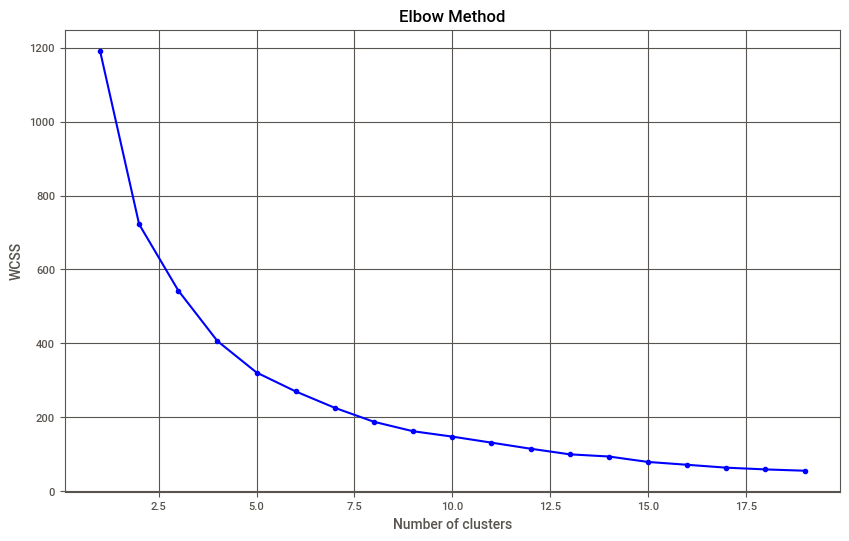

In [1080]:
# 3. Plot the Elbow Curve
plt.figure(figsize=(10, 6))
plt.plot(range(1, 20), wcss,  marker='o', linestyle='-', color='b')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [1081]:
# Optional: Apply k-Means using the optimal number of clusters
optimal_clusters = 3
model = KMeans(n_clusters=optimal_clusters, init='k-means++', max_iter=100000, n_init=10, random_state=0)

train

In [1082]:






y_pred = model.fit_predict(X_scaled)

Evaluation:

In [1083]:





X['kmeans'] = y_pred

In [1084]:

X['kmeans'].value_counts()

,count
kmeans,
0,203
1,88
2,7


In [1085]:
X[X['kmeans']==0].describe().T

,count,mean,std,min,25%,50%,75%,max
Product Price,203.0,3264.714286,1883.326951,849.0,1999.0,2699.0,3999.0,12499.0
RAM Size,203.0,11.231527,4.014897,8.0,8.0,8.0,16.0,24.0
Ranking,203.0,2.881773,0.417219,1.0,3.0,3.0,3.0,5.0
Storage Value,203.0,479.211823,114.868541,256.0,512.0,512.0,512.0,1024.0
kmeans,203.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0


In [1086]:
X[X['kmeans']==1].describe().T

,count,mean,std,min,25%,50%,75%,max
Product Price,88.0,8693.375000,4559.021044,849.0,5049.0,7799.0,11424.0,18549.0
RAM Size,88.0,24.477273,10.029814,8.0,16.0,18.0,32.0,48.0
Ranking,88.0,2.590909,0.559893,0.0,2.0,3.0,3.0,3.0
Storage Value,88.0,919.272727,207.708501,512.0,1024.0,1024.0,1024.0,1024.0
kmeans,88.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0


In [1087]:

X[X['kmeans']==2].describe().T

,count,mean,std,min,25%,50%,75%,max
Product Price,7.0,5523.285714,939.465400,4329.0,4699.0,5899.0,6259.0,6519.0
RAM Size,7.0,29.714286,6.047432,16.0,32.0,32.0,32.0,32.0
Ranking,7.0,6.428571,0.786796,6.0,6.0,6.0,6.5,8.0
Storage Value,7.0,1024.000000,0.000000,1024.0,1024.0,1024.0,1024.0,1024.0
kmeans,7.0,2.000000,0.000000,2.0,2.0,2.0,2.0,2.0


In [1019]:
X[X['kmeans']==3].describe().T

,count,mean,std,min,25%,50%,75%,max
Product Price,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Processor Speed,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
RAM Size,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ranking,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Storage Value,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
kmeans,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Combined

In [701]:
pip install sweetviz


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 53.1 MB/s eta 0:00:00


                                             |          | [  0%]   00:00 -> (? left)


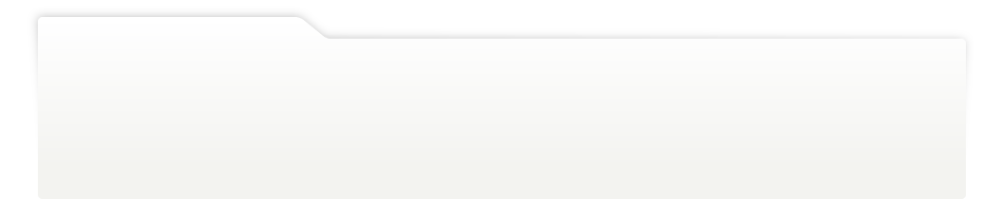
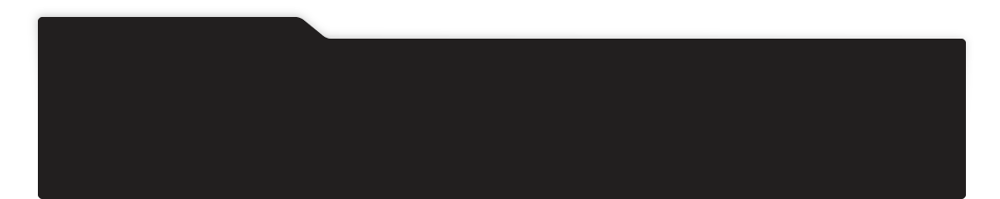
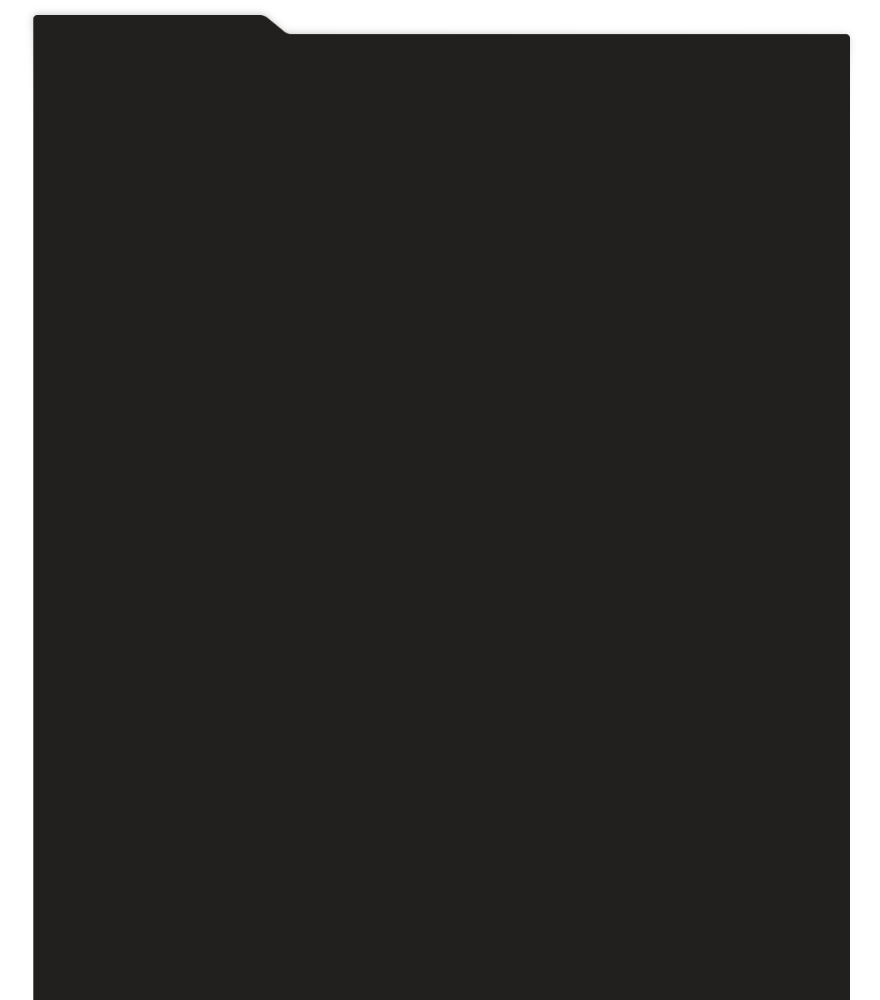
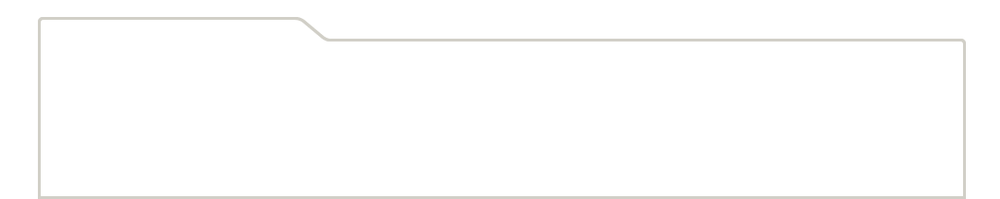
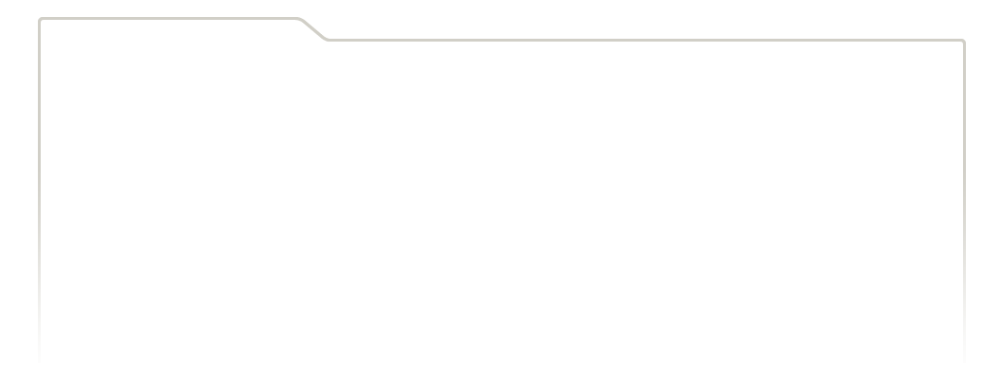
...
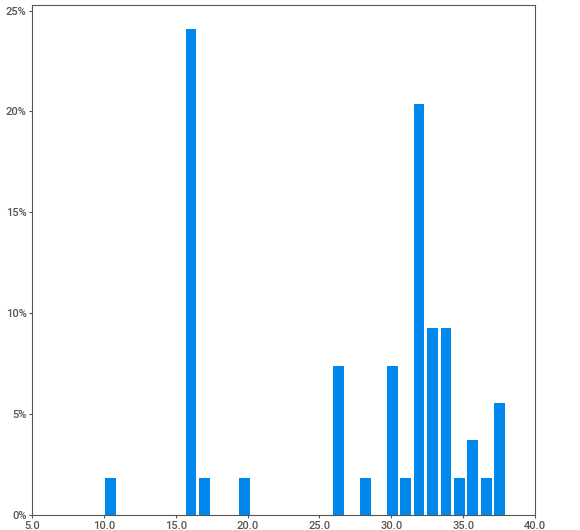
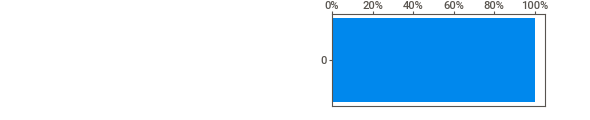
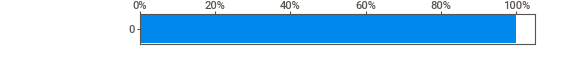
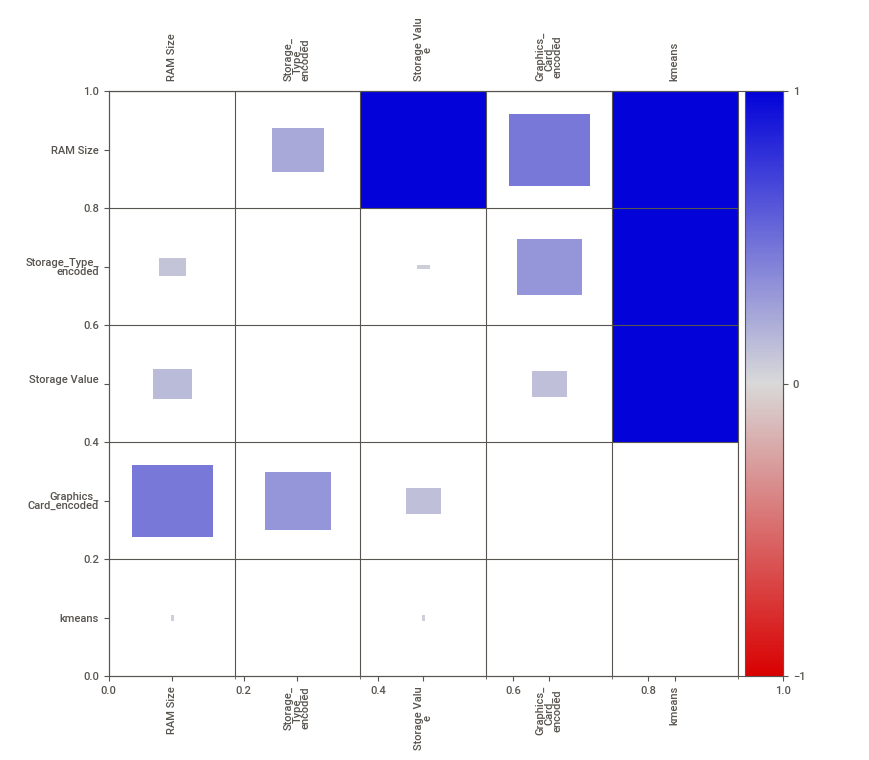
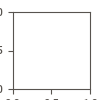

In [880]:
# importing sweetviz
import sweetviz as sv
#analyzing the dataset
advert_report = sv.analyze(X[X['kmeans']==0])
#display the report
advert_report.show_notebook()

In [709]:
storage

,Storage_Type_encoded,Storage Type
0,5,SSD M.2
1,5,SSD M.2
2,5,SSD M.2
3,4,SSD
4,5,SSD M.2
...,...,...
346,2,M.2 NVMe PCIe 4.0 SSD
348,4,SSD
355,4,SSD
357,4,SSD


In [769]:
s = storage.drop_duplicates(subset=['Storage_Type_encoded', 'Storage Type'])
print(s)

     Storage_Type_encoded                        Storage Type
0                       5                             SSD M.2
3                       4                                 SSD
44                      6  SSD M.2 + 16GB Intel Optane Memory
112                     7  SSD M.2 + 32GB Intel Optane Memory
125                     0                                 HDD
129                     8        SSD M.2 2280 PCIe 4.0x4 NVMe
247                     1                 HDD + 256GB SSD M.2
317                     2               M.2 NVMe PCIe 4.0 SSD
337                     3               NVMe PCIe Gen 4×4 SSD


In [770]:
Graphics

,Graphics_Card_encoded,Graphics Card
0,16,Intel Iris Xe Graphics
1,16,Intel Iris Xe Graphics
2,16,Intel Iris Xe Graphics
3,0,10-core GPU
4,16,Intel Iris Xe Graphics
...,...,...
346,16,Intel Iris Xe Graphics
348,6,32-core GPU
355,3,18-core GPU
357,3,18-core GPU


In [771]:
g = Graphics.drop_duplicates(subset=['Graphics_Card_encoded', 'Graphics Card'])
print(g)

     Graphics_Card_encoded                                      Graphics Card
0                       16                             Intel Iris Xe Graphics
3                        0                                        10-core GPU
5                       32                        NVIDIA GeForce RTX 4060 8GB
10                      17                                 Intel UHD Graphics
16                       5                                        30-core GPU
19                      15                          Intel Integrated Graphics
22                       3                                        18-core GPU
24                      33  NVIDIA GeForce RTX 4060 8GB GDDR6, Boost Clock...
30                       9                                         8-core GPU
32                      36  NVIDIA GeForce RTX 4070 8GB GDDR6, Boost Clock...
35                      27                        NVIDIA GeForce RTX 3050 6GB
37                      10                                AMD Ra

In [332]:
from sklearn.metrics import silhouette_score


In [1074]:
silhouette_avg = silhouette_score(X, y_pred)
silhouette_avg

0.5910497239467805